In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split, GridSearchCV
from modules.loader import ImmothepDataLoader
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import mean_squared_error

loader = ImmothepDataLoader()

DATASET_PATH = '../datas/CURATED/'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
loader.ensure_data_loaded()

Les fichiers sont correctement téléchargés


In [32]:
valeurs_foncieres = pd.read_csv(DATASET_PATH + "maison_filtre.csv", sep='|', encoding='utf-8')
# valeurs_foncieres = valeurs_foncieres.dropna(subset=['Surface terrain'])

In [3]:
extrait_df_valeurs_foncieres = pd.read_csv(DATASET_PATH + "maison_filtre.csv", sep=',', usecols=['Surface reelle bati', 'Nombre pieces principales', 'Surface terrain', 'Code postal'], encoding='utf-8')

In [14]:
data = extrait_df_valeurs_foncieres.values
X = data[:, 1:]  # all rows, no label
y = data[:, 0]  # all rows, label only
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20,random_state=2)
SGD = SGDRegressor(loss='squared_loss', penalty='l2', alpha=0.0001, l1_ratio=0.15)
improvements = list()
for z in range(1000):
    SGD.partial_fit(X_train, y_train)
    improvements.append(mean_squared_error(y_test, SGD.predict(X_test)))

NameError: name &#39;mean_squared_error&#39; is not defined

In [4]:
data = extrait_df_valeurs_foncieres.values
X = data[:, 1:]  # all rows, no label
y = data[:, 0]  # all rows, label only
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [5]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [10]:
model = SGDRegressor()

In [6]:
estimator = SGDRegressor()
# estimator = LinearRegression()  # LinearRegression works with sparse matrix
estimator.fit(X_train, y_train)
predicted = estimator.predict(X_train)

In [34]:
print(predicted)

[5.29170899e+14 2.49386148e+14 3.88692194e+14 ... 1.38566935e+13
 2.66613403e+14 3.78109816e+13]


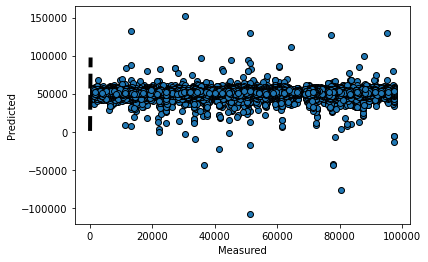

In [10]:

fig, ax = plt.subplots()
ax.scatter(y_train, predicted, edgecolors=(0, 0, 0))
ax.plot([X_train.min(), X_train.max()], [y_train.min(), y_train.max()], 'k--', lw=4)
ax.set_xlabel('Measured')
ax.set_ylabel('Predicted')
plt.show()

In [35]:
model.fit(X_train, y_train)
score = model.score(X_train, y_train)
print("R-squared:", score)

R-squared: 0.0034404090727345737


In [11]:
param_grid = {
    'alpha': 10.0 ** -np.arange(1, 7),
    'loss': ['squared_loss', 'huber', 'epsilon_insensitive'],
    'penalty': ['l2', 'l1', 'elasticnet'],
    'learning_rate': ['constant', 'optimal', 'invscaling'],
}
clf = GridSearchCV(model, param_grid)
clf.fit(X_train, y_train)
print("Best score: " + str(clf.best_score_))

KeyboardInterrupt: 

In [6]:
extrait_df_valeurs_foncieres.head()

,Code postal,Surface reelle bati,Nombre pieces principales,Surface terrain
0,1000.0,20.0,1.0,NaN
1,1000.0,62.0,3.0,NaN
2,1000.0,0.0,0.0,NaN
3,1160.0,90.0,4.0,940.0
4,1370.0,101.0,5.0,490.0


In [16]:
import sklearn.datasets
iris_dataset = sklearn.datasets.load_iris()
X, y = extrait_df_valeurs_foncieres['Surface reelle bati'], extrait_df_valeurs_foncieres['Nombre pieces principales']
print(X, y)

0           20.0
1           62.0
2            0.0
3           90.0
4          101.0
           ...  
2535786    120.0
2535787      0.0
2535788     44.0
2535789    100.0
2535790     97.0
Name: Surface reelle bati, Length: 2535791, dtype: float64 0          1.0
1          3.0
2          0.0
3          4.0
4          5.0
          ... 
2535786    5.0
2535787    0.0
2535788    2.0
2535789    0.0
2535790    3.0
Name: Nombre pieces principales, Length: 2535791, dtype: float64


In [14]:
import sklearn.datasets
import random
from sklearn.model_selection import train_test_split
x = random.uniform(0, 9)
surface_reelle_bati, nombre_pieces_principales, surface_terrain, code_postal = train_test_split(X, extrait_df_valeurs_foncieres)

ValueError: Found input variables with inconsistent numbers of samples: [150, 2535791]

In [ ]:
for local in valeurs_foncieres['Type local'].drop_duplicates().values:
    print(local)
print()
# appartement = valeurs_foncieres[valeurs_foncieres['Type local'] == 'Appartement']
maison = valeurs_foncieres[valeurs_foncieres['Type local'] == 'Maison']
# dependance = valeurs_foncieres[valeurs_foncieres['Type local'] == 'Dépendance']
# none_local = valeurs_foncieres[valeurs_foncieres['Type local'].isna()]
# industriel = valeurs_foncieres[valeurs_foncieres['Type local'] == 'Local industriel. commercial ou assimilé']

print('nb local :\t', len(valeurs_foncieres), '\tsoit\t', round(len(valeurs_foncieres)/len(valeurs_foncieres)*100), ' % des locaux' )
# print('nb appart :\t', len(appartement), '\tsoit\t', round(len(appartement)/len(valeurs_foncieres)*100), ' % des locaux' )
print('nb maison :\t', len(maison), '\tsoit\t', round(len(maison)/len(valeurs_foncieres)*100), ' % des locaux' )
# print('nb dependance :\t', len(dependance), '\tsoit\t', round(len(dependance)/len(valeurs_foncieres)*100), ' % des locaux' )
# print('nb none_local :\t', len(none_local), '\tsoit\t', round(len(none_local)/len(valeurs_foncieres)*100), ' % des locaux' )
# print('nb industriel :\t', len(industriel), '\tsoit\t', round(len(industriel)/len(valeurs_foncieres)*100), ' % des locaux' )

In [ ]:
# maison_non_bati = maison[maison['Surface reelle bati'].isna()]
# maison_non_terrain = maison[maison['Surface terrain'].isna()]
# maison_non_valeur = maison[maison['Valeur fonciere'].isna()]
# maison_non_pieces = maison[maison['Nombre pieces principales'].isna()]
# maison_non_postal = maison[maison['Code postal'].isna()]

# print('nb maison non bati \t', len(maison_non_bati), '\tsoit\t', round(len(maison_non_bati)/len(maison)*100, 1), ' % des maisons' )
# print('nb maison sans terrain \t', len(maison_non_terrain), '\tsoit\t', round(len(maison_non_terrain)/len(maison)*100, 1), ' % des maisons' )
# print('nb maison sans valeur \t', len(maison_non_valeur), '\tsoit\t', round(len(maison_non_valeur)/len(maison)*100, 1), ' % des maisons' )
# print('nb maison sans piece \t', len(maison_non_pieces), '\tsoit\t', round(len(maison_non_pieces)/len(maison)*100, 1), ' % des maisons' )
# print('nb maison sans code postal \t', len(maison_non_postal), '\tsoit\t', round(len(maison_non_postal)/len(maison)*100, 1), ' % des maisons' )

maison_filtre = maison.dropna(subset=['Surface reelle bati','Surface terrain', 'Valeur fonciere', 'Nombre pieces principales', 'Code postal'])
print(len(maison_filtre), ' maisons')
maison_filtre.head()

In [ ]:
or mutation in maison_filtre['Nature mutation'].drop_duplicates().values:
    print(mutation)